<a href="https://colab.research.google.com/github/prathamsss/Airport-Security/blob/master/Fruit_Quality_Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [4]:
!pip install labelme2coco

In [10]:
# import os
# train ="/content/drive/MyDrive/ML/fruit_quality/detection/train/"
# val = "/content/drive/MyDrive/ML/fruit_quality/detection/val"

# import labelme2coco
# labelme_folder = val
# save_json_path = "/content/drive/MyDrive/ML/fruit_quality/detection/coco_val.json"

# labelme2coco.convert(labelme_folder, save_json_path)  

In [1]:
# install dependencies: 
!pip install pyyaml==5.1 pycocotools>=2.0.1
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version
# opencv is pre-installed on colab

1.7.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [2]:
import torch
assert torch.__version__.startswith("1.7")
!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
# exit(0)  # After installation, you need to "restart runtime" in Colab. This line can also restart runtime

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.7/index.html
     |████████████████████████████████| 6.8MB 11.9MB/s 
     |████████████████████████████████| 2.2MB 12.6MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.2.post20201218-cp36-none-any.whl size=40701 sha256=2b26b3f1c111fd97aef09a70aa012713fd46b5e63330a39b18f1994a03b5959c
  Stored in directory: /root/.cache/pip/wheels/b5/83/3f/e74a72d264351b5ada512da845a5c6abb81a34f6333c3a54ce
  Created wheel for iopath: filename=iopath-0.1.2-cp36-none-any.whl size=10508 sha256=e8a0a572039caa6f2f91733c1232ffa5e391761932ceef321061efe36955fc90
  Stored in directory: /root/.cache/pip/wheels/9e/01/e4/1b68f5a2a6b9450ea4246d91840a77e1169f7d4722d76bbc47
Successfully built fvcore iopath
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 7.0.0
    Uninstalling Pillow-7.0.0:
      Successfully uninstalled Pillow-7

In [3]:
!pip install pillow==4.1.1
%reload_ext autoreload
# %autoreload

     |████████████████████████████████| 5.7MB 5.8MB/s 
     |████████████████████████████████| 112kB 63.3MB/s 
  Created wheel for olefile: filename=olefile-0.46-py2.py3-none-any.whl size=35416 sha256=8014cbe6c79e31a5c6919fa29b4ec9cc86510b0aeebd3b94cdcc7a0748610370
  Stored in directory: /root/.cache/pip/wheels/4b/f4/11/bc4166107c27f07fd7bba707ffcb439619197638a1ac986df3
Successfully built olefile
ERROR: scikit-image 0.16.2 has requirement pillow>=4.3.0, but you'll have pillow 4.1.1 which is incompatible.
ERROR: detectron2 0.3+cu101 has requirement Pillow>=7.1, but you'll have pillow 4.1.1 which is incompatible.
ERROR: albumentations 0.1.12 has requirement imgaug<0.2.7,>=0.2.5, but you'll have imgaug 0.2.9 which is incompatible.
  Found existing installation: Pillow 8.1.0
    Uninstalling Pillow-8.1.0:
      Successfully uninstalled Pillow-8.1.0


In [1]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
import os
import random
from detectron2.utils.visualizer import Visualizer
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import matplotlib.pyplot as plt

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.datasets import register_coco_instances
from detectron2.data import DatasetCatalog
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data import DatasetCatalog
i=0
from detectron2.utils.visualizer import Visualizer
import os

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 

** fvcore version of PathManager will be deprecated soon. **
** Please migrate to the version in iopath repo. **
https://github.com/facebookresearch/iopath 



In [4]:
# import shutil
train ="/content/drive/MyDrive/ML/fruit_quality/detection/train/"
val = "/content/drive/MyDrive/ML/fruit_quality/detection/val/"

des = "/content/drive/MyDrive/ML/fruit_quality/detection/val_img" 
# for i in os.listdir(val):
#   if i.endswith('.json'):
#     pass
#   else:
#      shutil.copy(val+i,des)  


In [5]:
len(os.listdir(des)) ,len(os.listdir(val)) 

(189, 378)

In [6]:
train_json_path="/content/drive/MyDrive/ML/fruit_quality/detection/coco_train.json"
train_img_path= "/content/drive/MyDrive/ML/fruit_quality/detection/train_img"
test_json_path = "/content/drive/MyDrive/ML/fruit_quality/detection/coco_val.json"
test_img_path = "/content/drive/MyDrive/ML/fruit_quality/detection/val_img"


register_coco_instances("MyTrain", {}, train_json_path, train_img_path)
register_coco_instances("MyTest", {}, test_json_path, test_img_path)


In [7]:
train_data=detectron2.data.datasets.load_coco_json(train_json_path, train_img_path, dataset_name='MyTrain', extra_annotation_keys=None)
test_data=detectron2.data.datasets.load_coco_json(test_json_path, test_img_path, dataset_name='MyTest', extra_annotation_keys=None)

print("No of Train = ",len(train_data), "No of Test = ",len(test_data))

meta = MetadataCatalog.get('MyTrain')
print('classes = ',(meta))

MetadataCatalog.get('MyTrain').thing_classes

[01/08 19:14:39 d2.data.datasets.coco]: Loading /content/drive/MyDrive/ML/fruit_quality/detection/coco_train.json takes 1.54 seconds.
[01/08 19:14:39 d2.data.datasets.coco]: Loaded 401 images in COCO format from /content/drive/MyDrive/ML/fruit_quality/detection/coco_train.json
[01/08 19:14:40 d2.data.datasets.coco]: Loaded 189 images in COCO format from /content/drive/MyDrive/ML/fruit_quality/detection/coco_val.json
No of Train =  401 No of Test =  189
classes =  Metadata(evaluator_type='coco', image_root='/content/drive/MyDrive/ML/fruit_quality/detection/train_img', json_file='/content/drive/MyDrive/ML/fruit_quality/detection/coco_train.json', name='MyTrain', thing_classes=['low', 'high'], thing_dataset_id_to_contiguous_id={1: 0, 2: 1})


['low', 'high']

[01/08 19:14:44 d2.data.datasets.coco]: Loaded 189 images in COCO format from /content/drive/MyDrive/ML/fruit_quality/detection/coco_val.json
/content/drive/MyDrive/ML/fruit_quality/detection/val/apple1 (415).png


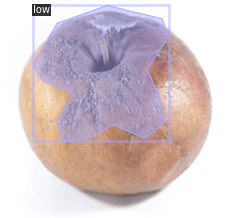

/content/drive/MyDrive/ML/fruit_quality/detection/val/apple1 (525).png


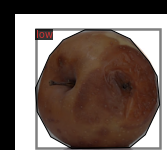

/content/drive/MyDrive/ML/fruit_quality/detection/val/apple1 (479).png


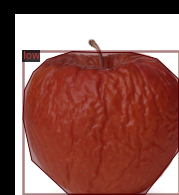

In [8]:
import os
import random
from detectron2.utils.visualizer import Visualizer
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()
import numpy as np
import cv2
import matplotlib.pyplot as plt
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
i=0
import matplotlib.image as mpimg

dataset_dicts = DatasetCatalog.get("MyTest")
for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d['file_name'])
    print(d['file_name'])
    visualizer = Visualizer(img[:, :, ::-1], metadata=meta, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])




In [10]:
from detectron2.engine import DefaultTrainer
from detectron2.config import get_cfg
import os
cfg1 = get_cfg()
cfg1.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x.yaml"))
cfg1.DATASETS.TRAIN = ('MyTrain',)
cfg1.DATASETS.TEST = ()   # no metrics implemented for this dataset
cfg1.DATALOADER.NUM_WORKERS = 2
cfg1.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x.yaml")
cfg1.SOLVER.IMS_PER_BATCH = 2

cfg1.SOLVER.MAX_ITER = 1300

cfg1.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = (
    64
)
cfg1.SOLVER.BASE_LR = 0.0001

cfg1.MODEL.ROI_HEADS.NUM_CLASSES = 2
os.makedirs(cfg1.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg1) 
trainer.resume_or_load(resume=False)
trainer.train()

[01/08 19:15:23 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): ResNet(
    (stem): BasicStem(
      (conv1): Conv2d(
        3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
        (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
      )
    )
    (res2): Sequential(
      (0): BottleneckBlock(
        (shortcut): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
        )
        (conv1): Conv2d(
          64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv2): Conv2d(
          64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
        (conv3): Conv2d(
          64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False
          (norm): FrozenBatchNorm2d(num_features=256, eps=1e-05)
 

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 2048) in the checkpoint but (3, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 2048) in the checkpoint but (8, 2048) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.mask_head.predictor.weight' to the model due to incompatible shapes: (80, 256, 1, 1) in the checkpoint but (2, 256, 1, 1) in

[01/08 19:15:23 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/structures/masks.py:345: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/utils/python_arg_parser.cpp:882.)
  item = item.nonzero().squeeze(1).cpu().numpy().tolist()
/usr/local/lib/python3.6/dist-packages/detectron2/modeling/roi_heads/fast_rcnn.py:217: UserWarning: This overload of nonzero is deprecated:
	nonzero()
Consider using one of the following signatures instead:
	nonzero(*, bool as_tuple) (Triggered internally at  /pytorch/torch/csrc/

[01/08 19:15:37 d2.utils.events]:  eta: 0:14:47  iter: 19  total_loss: 2.9  loss_cls: 1.05  loss_box_reg: 0.9244  loss_mask: 0.6912  loss_rpn_cls: 0.1118  loss_rpn_loc: 0.09842  time: 0.6868  data_time: 0.4124  lr: 1.9981e-06  max_mem: 1673M
[01/08 19:15:50 d2.utils.events]:  eta: 0:13:13  iter: 39  total_loss: 2.817  loss_cls: 1.013  loss_box_reg: 0.9346  loss_mask: 0.6894  loss_rpn_cls: 0.07115  loss_rpn_loc: 0.08955  time: 0.6594  data_time: 0.3430  lr: 3.9961e-06  max_mem: 1706M
[01/08 19:16:02 d2.utils.events]:  eta: 0:12:39  iter: 59  total_loss: 2.81  loss_cls: 0.9479  loss_box_reg: 1.006  loss_mask: 0.6858  loss_rpn_cls: 0.09026  loss_rpn_loc: 0.09065  time: 0.6375  data_time: 0.3322  lr: 5.9941e-06  max_mem: 1706M
[01/08 19:16:15 d2.utils.events]:  eta: 0:13:12  iter: 79  total_loss: 2.685  loss_cls: 0.8559  loss_box_reg: 0.9531  loss_mask: 0.6799  loss_rpn_cls: 0.1365  loss_rpn_loc: 0.07153  time: 0.6478  data_time: 0.4037  lr: 7.9921e-06  max_mem: 1706M
[01/08 19:16:28 d2.ut

In [52]:
import os
cfg1.MODEL.WEIGHTS = os.path.join(cfg1.OUTPUT_DIR, "/content/drive/MyDrive/ML/fruit_quality/detection/output/model_final.pth")
cfg1.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7
cfg1.MODEL.RPN.NMS_THRESH = 0.25    # set the testing threshold for this model
cfg1.DATASETS.TEST = ('MyTest',)
predictor1 = DefaultPredictor(cfg1)

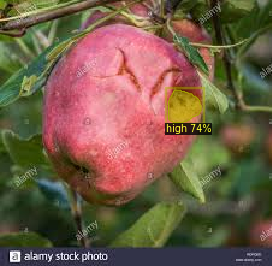

In [53]:
path = "/content/drive/MyDrive/ML/fruit_quality/classification/testing images/image.jpeg"
im = cv2.imread(path)
outputs = predictor1(im)
v = Visualizer(im[:, :, ::-1], MetadataCatalog.get(cfg1.DATASETS.TRAIN[0]), scale=1.2)
v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
cv2_imshow(v.get_image()[:, :, ::-1])

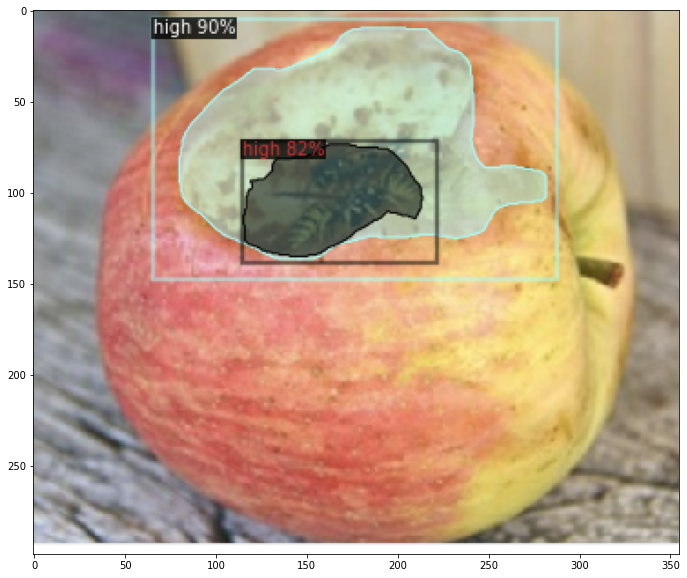

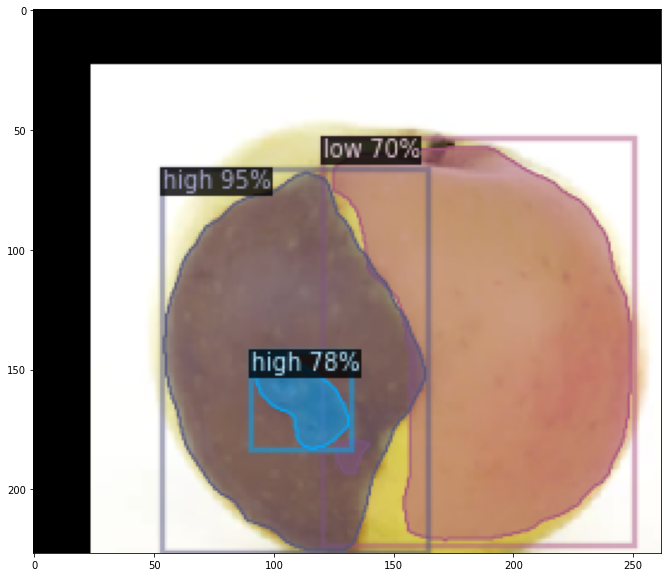

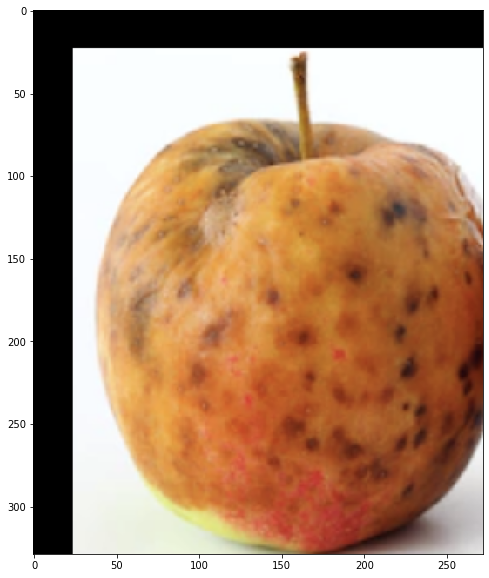

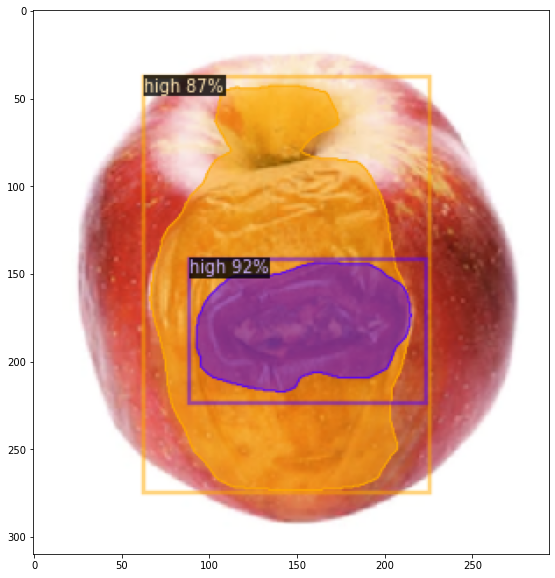

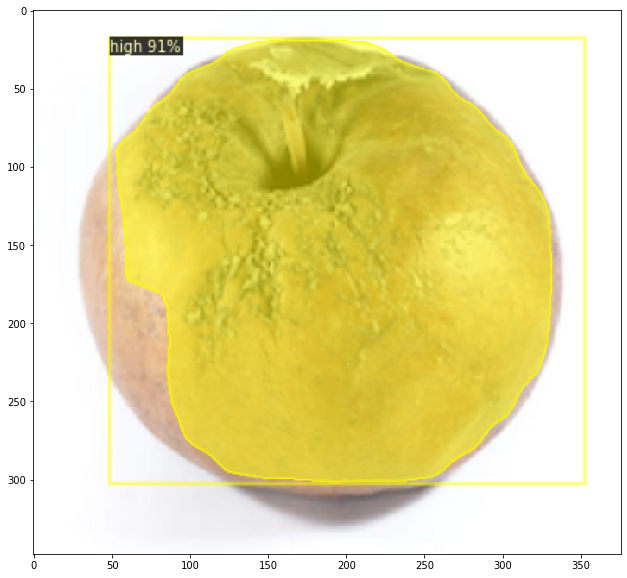

...

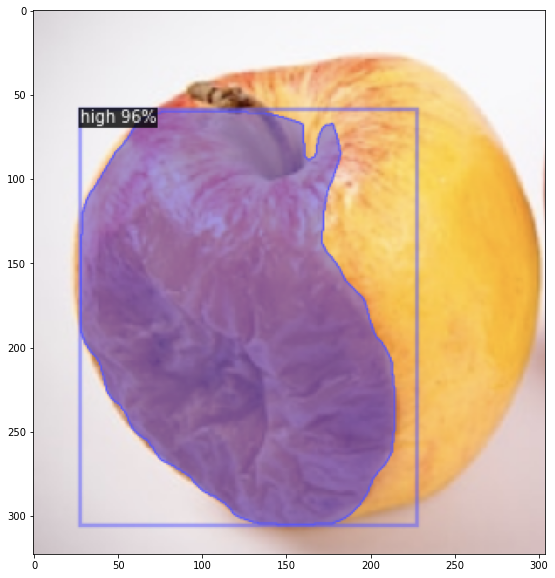

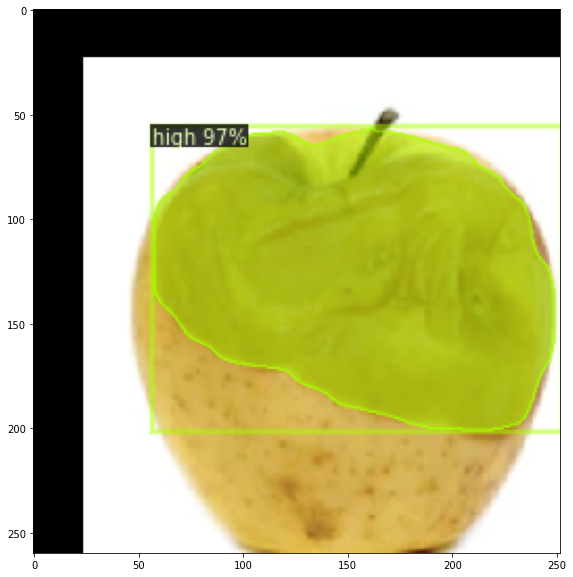

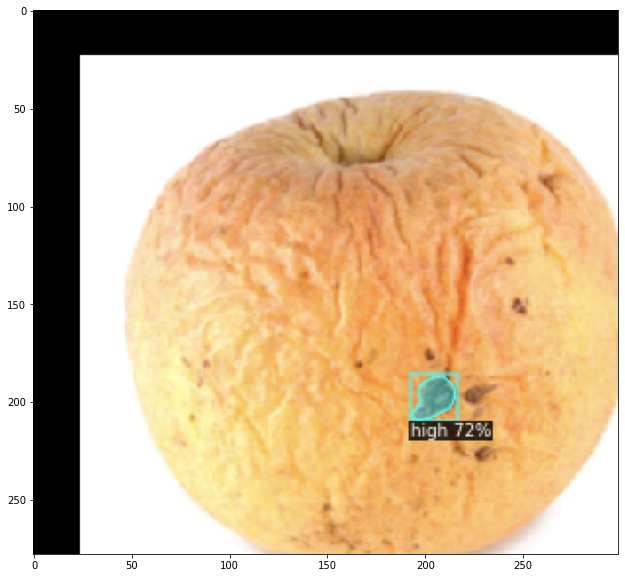

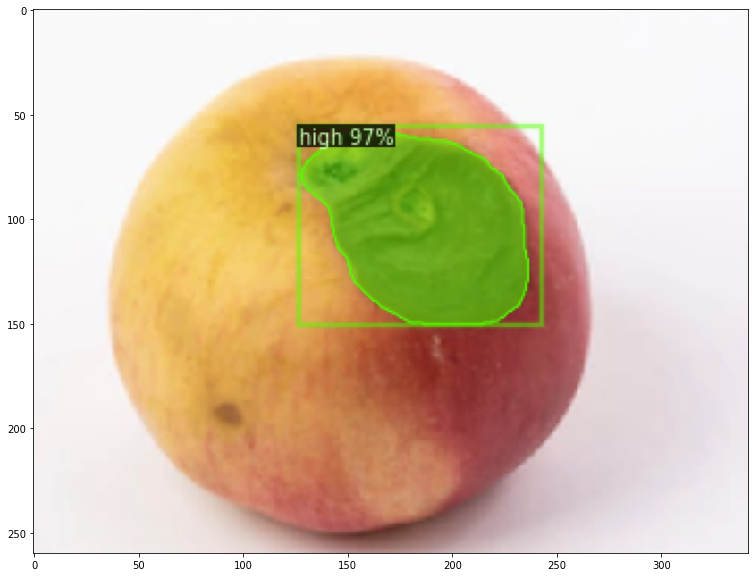

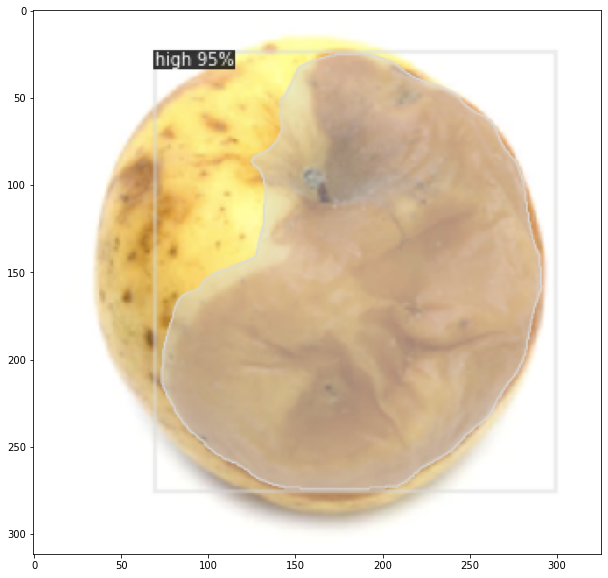

In [54]:
dir = "/content/drive/MyDrive/ML/fruit_quality/detection/val_img/"
c=0
for d in os.listdir(dir):  
   if  d.endswith('.jpeg') or d.endswith('.png'):
     im = cv2.imread(dir+d)
    
     outputs = predictor1(im)
     v = Visualizer(im[:, :, ::-1], metadata=meta, scale=0.8)
     v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    #  print(outputs["instances"])
     plt.figure(figsize = (14, 10))
     plt.imshow(cv2.cvtColor(v.get_image()[:, :, ::-1], cv2.COLOR_BGR2RGB))
     plt.show()
     c=c+1
     if c==35:
       break

In [47]:
%load_ext tensorboard
%tensorboard --logdir output


The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 460), started 0:01:23 ago. (Use '!kill 460' to kill it.)

<IPython.core.display.Javascript object>

In [48]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("MyTest", ("bbox", "segm"), True, output_dir="/content/output")
val_loader = build_detection_test_loader(cfg1, "MyTest")


[01/08 19:33:10 d2.data.datasets.coco]: Loaded 189 images in COCO format from /content/drive/MyDrive/ML/fruit_quality/detection/coco_val.json
[01/08 19:33:10 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[01/08 19:33:10 d2.data.common]: Serializing 189 elements to byte tensors and concatenating them all ...
[01/08 19:33:10 d2.data.common]: Serialized dataset takes 0.11 MiB


In [49]:
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[01/08 19:34:08 d2.evaluation.evaluator]: Start inference on 189 images
[01/08 19:34:12 d2.evaluation.evaluator]: Inference done 11/189. 0.2764 s / img. ETA=0:00:50
[01/08 19:34:17 d2.evaluation.evaluator]: Inference done 29/189. 0.2810 s / img. ETA=0:00:47
[01/08 19:34:22 d2.evaluation.evaluator]: Inference done 47/189. 0.2813 s / img. ETA=0:00:41
[01/08 19:34:27 d2.evaluation.evaluator]: Inference done 64/189. 0.2858 s / img. ETA=0:00:37
[01/08 19:34:33 d2.evaluation.evaluator]: Inference done 82/189. 0.2843 s / img. ETA=0:00:31
[01/08 19:34:38 d2.evaluation.evaluator]: Inference done 99/189. 0.2849 s / img. ETA=0:00:26
[01/08 19:34:43 d2.evaluation.evaluator]: Inference done 116/189. 0.2871 s / img. ETA=0:00:21
[01/08 19:34:48 d2.evaluation.evaluator]: Inference done 133/189. 0.2893 s / img. ETA=0:00:16
[01/08 19:34:54 d2.evaluation.evaluator]: Inference done 150/189. 0.2884 s / img. ETA=0:00:11
[01/08 19:34:59 d2.evaluation.evaluator]: Inference done 167/189. 0.2881 s / img. ETA=0: